In [1]:
from shapely.geometry import Point
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
import numpy as np

# Reading in CSV Files

In [2]:
derecho_911 = pd.read_csv('../data/derecho_911_calls_clean.csv')
derecho_911.head()

,date_time,call_type,lat,lng,cell_tower_address
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE
2,5/3/2020 16:30,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N
3,5/3/2020 16:30,911 Calls,36.130021,-86.927819,5758 RIVER RD - SW
4,5/3/2020 16:31,911 Calls,36.142380,-86.881882,3744B ANNEX AVE - SE


In [3]:
derecho_dispatch = pd.read_csv('../data/derecho_comp_dispatch_clean.csv')
derecho_dispatch.head()

,date_time,loc,lat,lng,incident_description
0,5/3/2020 4:31:07 PM,901 KENWICK CT W,36.046877,-86.962526,ELECTRICAL HAZARD
1,5/3/2020 4:32:18 PM,8036 ARBOR DR,36.082491,-86.940680,ELECTRICAL HAZARD
2,5/3/2020 4:32:23 PM,119 DUE WEST AV E,36.248029,-86.716875,NOT ALERT COPD
3,5/3/2020 4:33:04 PM,630 GALLATIN PKE S,36.256491,-86.714817,ABDOMINAL PAIN
4,5/3/2020 4:33:52 PM,615 W HILLWOOD DR,36.129690,-86.879834,ELECTRICAL HAZARD


In [4]:
tornado_911 = pd.read_csv('../data/tornado_911_clean.csv')
tornado_911.head()

,date_time,call_type,lat,lng,cell_tower_address
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector
1,3/3/2020 0:36,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE
2,3/3/2020 0:36,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector
3,3/3/2020 0:36,911 Calls,NaN,NaN,526 FOUNDRY DR
4,3/3/2020 0:36,911 Calls,36.233467,-86.721077,5007B RUSKIN AVE - N


In [5]:
tornado_dispatch = pd.read_csv('../data/tornado_comp_dispatch_clean.csv')
tornado_dispatch.head()

,date_time,loc,lat,lng,incident_description
0,3/3/2020 12:36:34 AM,6205 COCKRILL BEND CIR,36.182002,-86.894052,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
1,3/3/2020 12:37:24 AM,7337 COCKRILL BEND BLVD,36.175666,-86.894978,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
2,3/3/2020 12:38:17 AM,110 TUNE AIRPORT DR,36.179299,-86.883727,STRUCTURE FIRE COMMERCIAL INDUSTRIAL
3,3/3/2020 12:39:40 AM,555 MARRIOTT DR,36.151108,-86.689921,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD
4,3/3/2020 12:39:42 AM,1414 COUNTY HOSPITAL RD,36.177926,-86.845934,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD


# Reading geojson File

In [6]:
zipcodes = gpd.read_file('../data/zipcodes.geojson')
zipcodes.head()

,zip,objectid,po_name,shape_stlength,shape_starea,geometry
0,37115,1,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37216,3,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ..."
2,37204,9,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37027,11,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ..."
4,37064,18,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."


In [7]:
zipcodes.columns

Index(['zip', 'objectid', 'po_name', 'shape_stlength', 'shape_starea',
       'geometry'],
      dtype='object')

In [8]:
zipcodes = zipcodes[['zip', 'po_name', 'shape_stlength', 'shape_starea', 'geometry']]
zipcodes.head()

,zip,po_name,shape_stlength,shape_starea,geometry
0,37115,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37216,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ..."
2,37204,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37027,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ..."
4,37064,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."


In [9]:
zipcodes.columns =['zipcode', 'po_name', 'shape_length', 'shape_area', 'geometry']
zipcodes.head()

,zipcode,po_name,shape_length,shape_area,geometry
0,37115,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37216,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ..."
2,37204,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37027,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ..."
4,37064,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."


# Adding Geometry Columns

In [10]:
tornado_911['geometry'] = tornado_911.apply(lambda x: Point((float(x.lng),
                                                                    float(x.lat))),
                                                    axis=1)
tornado_911.head()

,date_time,call_type,lat,lng,cell_tower_address,geometry
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,POINT (-86.665779 36.072708)
1,3/3/2020 0:36,911 Calls,36.159634,-86.841904,4507D KENTUCKY AV - SE,POINT (-86.841904 36.159634)
2,3/3/2020 0:36,911 Calls,36.264153,-86.708862,329 THELMA ST - S Sector,POINT (-86.708862 36.264153)
3,3/3/2020 0:36,911 Calls,NaN,NaN,526 FOUNDRY DR,POINT (nan nan)
4,3/3/2020 0:36,911 Calls,36.233467,-86.721077,5007B RUSKIN AVE - N,POINT (-86.72107700000002 36.233467)


In [11]:
tornado_dispatch['geometry'] = tornado_dispatch.apply(lambda x: Point((float(x.lng),
                                                                              float(x.lat))),
                                                             axis=1)
tornado_dispatch.head()

,date_time,loc,lat,lng,incident_description,geometry
0,3/3/2020 12:36:34 AM,6205 COCKRILL BEND CIR,36.182002,-86.894052,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD,POINT (-86.89405212 36.18200191)
1,3/3/2020 12:37:24 AM,7337 COCKRILL BEND BLVD,36.175666,-86.894978,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD,POINT (-86.89497756999999 36.175666)
2,3/3/2020 12:38:17 AM,110 TUNE AIRPORT DR,36.179299,-86.883727,STRUCTURE FIRE COMMERCIAL INDUSTRIAL,POINT (-86.88372740000001 36.17929946)
3,3/3/2020 12:39:40 AM,555 MARRIOTT DR,36.151108,-86.689921,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD,POINT (-86.6899214 36.1511077)
4,3/3/2020 12:39:42 AM,1414 COUNTY HOSPITAL RD,36.177926,-86.845934,GENERAL ALARM COMMERCIAL INDUSTRIAL BUILD,POINT (-86.84593411 36.17792604)


In [12]:
derecho_911['geometry'] = derecho_911.apply(lambda x: Point((float(x.lng),
                                                                    float(x.lat))),
                                                   axis=1)
derecho_911.head()

,date_time,call_type,lat,lng,cell_tower_address,geometry
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.716847 36.247802)
1,5/3/2020 16:30,911 Calls,36.143108,-86.800621,1161 21ST AV S - SE,POINT (-86.80062099999998 36.14310800000001)
2,5/3/2020 16:30,911 Calls,36.100516,-87.056329,8013 C MCCRORY LN - N,POINT (-87.05632900000001 36.100516)
3,5/3/2020 16:30,911 Calls,36.130021,-86.927819,5758 RIVER RD - SW,POINT (-86.927819 36.130021)
4,5/3/2020 16:31,911 Calls,36.142380,-86.881882,3744B ANNEX AVE - SE,POINT (-86.88188199999998 36.14238)


In [13]:
derecho_dispatch['geometry'] = derecho_dispatch.apply(lambda x: Point((float(x.lng),
                                                                              float(x.lat))),
                                                             axis=1)
derecho_dispatch.head()

,date_time,loc,lat,lng,incident_description,geometry
0,5/3/2020 4:31:07 PM,901 KENWICK CT W,36.046877,-86.962526,ELECTRICAL HAZARD,POINT (-86.96252641 36.04687715)
1,5/3/2020 4:32:18 PM,8036 ARBOR DR,36.082491,-86.940680,ELECTRICAL HAZARD,POINT (-86.94067952 36.08249081)
2,5/3/2020 4:32:23 PM,119 DUE WEST AV E,36.248029,-86.716875,NOT ALERT COPD,POINT (-86.71687484 36.24802948)
3,5/3/2020 4:33:04 PM,630 GALLATIN PKE S,36.256491,-86.714817,ABDOMINAL PAIN,POINT (-86.71481656 36.25649117)
4,5/3/2020 4:33:52 PM,615 W HILLWOOD DR,36.129690,-86.879834,ELECTRICAL HAZARD,POINT (-86.87983392 36.12968971)


# Creating Geo DataFrames

In [14]:
tornado_911_geo = gpd.GeoDataFrame(tornado_911,
                                  crs = zipcodes.crs,
                                  geometry = tornado_911['geometry'])

In [15]:
type(tornado_911_geo)

geopandas.geodataframe.GeoDataFrame

In [16]:
derecho_911_geo = gpd.GeoDataFrame(derecho_911,
                                  crs = zipcodes.crs,
                                  geometry = derecho_911['geometry'])

In [17]:
type(derecho_911_geo)

geopandas.geodataframe.GeoDataFrame

In [18]:
derecho_911_geo.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1549 entries, 0 to 1548
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   date_time           1549 non-null   object  
 1   call_type           1549 non-null   object  
 2   lat                 1483 non-null   float64 
 3   lng                 1483 non-null   float64 
 4   cell_tower_address  1525 non-null   object  
 5   geometry            1549 non-null   geometry
dtypes: float64(2), geometry(1), object(3)
memory usage: 72.7+ KB


# Merging Tornado/Derecho 911 Data w/ Zip Codes

In [19]:
tornado911_by_zip = gpd.sjoin(tornado_911_geo, zipcodes, op = 'within')
tornado911_by_zip.head()

,date_time,call_type,lat,lng,cell_tower_address,geometry,index_right,zipcode,po_name,shape_length,shape_area
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,POINT (-86.66578 36.07271),51,37013,ANTIOCH,349164.88029162859,1150567551.5894165
10,3/3/2020 0:38,911 Calls,36.052055,-86.648331,745 BELL RD - OMNI Sector,POINT (-86.64833 36.05206),51,37013,ANTIOCH,349164.88029162859,1150567551.5894165
64,3/3/2020 0:53,911 Calls,36.050048,-86.650629,5646 AMALIE DR - SE,POINT (-86.65063 36.05005),51,37013,ANTIOCH,349164.88029162859,1150567551.5894165
194,3/3/2020 1:29,911 Calls,36.068298,-86.681550,3930 APACHE TRAIL - SE SECTOR,POINT (-86.68155 36.06830),51,37013,ANTIOCH,349164.88029162859,1150567551.5894165
234,3/3/2020 1:40,911 Calls,36.058578,-86.699745,5067 COLEMONT DR - N,POINT (-86.69974 36.05858),51,37013,ANTIOCH,349164.88029162859,1150567551.5894165


In [20]:
tornado911_by_zip = tornado911_by_zip[['date_time', 'call_type', 'lat', 'lng', 'cell_tower_address', 'geometry', 'zipcode', 'po_name', 'shape_length', 'shape_area']]
tornado911_by_zip.head()

,date_time,call_type,lat,lng,cell_tower_address,geometry,zipcode,po_name,shape_length,shape_area
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,POINT (-86.66578 36.07271),37013,ANTIOCH,349164.88029162859,1150567551.5894165
10,3/3/2020 0:38,911 Calls,36.052055,-86.648331,745 BELL RD - OMNI Sector,POINT (-86.64833 36.05206),37013,ANTIOCH,349164.88029162859,1150567551.5894165
64,3/3/2020 0:53,911 Calls,36.050048,-86.650629,5646 AMALIE DR - SE,POINT (-86.65063 36.05005),37013,ANTIOCH,349164.88029162859,1150567551.5894165
194,3/3/2020 1:29,911 Calls,36.068298,-86.681550,3930 APACHE TRAIL - SE SECTOR,POINT (-86.68155 36.06830),37013,ANTIOCH,349164.88029162859,1150567551.5894165
234,3/3/2020 1:40,911 Calls,36.058578,-86.699745,5067 COLEMONT DR - N,POINT (-86.69974 36.05858),37013,ANTIOCH,349164.88029162859,1150567551.5894165


In [21]:
derecho911_by_zip = gpd.sjoin(derecho_911_geo, zipcodes, op = 'within')
derecho911_by_zip.head()

,date_time,call_type,lat,lng,cell_tower_address,geometry,index_right,zipcode,po_name,shape_length,shape_area
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.71685 36.24780),0,37115,MADISON,178783.02488886821,596553400.57885742
68,5/3/2020 16:44,911 Calls,36.265547,-86.736116,524 BOYDS HILLTOP DR - SW,POINT (-86.73612 36.26555),0,37115,MADISON,178783.02488886821,596553400.57885742
78,5/3/2020 16:46,911 Calls,36.250710,-86.689766,607E LARKIN SPRINGS RD - SW,POINT (-86.68977 36.25071),0,37115,MADISON,178783.02488886821,596553400.57885742
79,5/3/2020 16:46,911 Calls,36.259485,-86.678717,96 D VANDIVER DR - SECTOR S,POINT (-86.67872 36.25948),0,37115,MADISON,178783.02488886821,596553400.57885742
100,5/3/2020 16:51,911 Calls,36.253467,-86.730366,619 DUE WEST AVE. W - NE SECTOR,POINT (-86.73037 36.25347),0,37115,MADISON,178783.02488886821,596553400.57885742


# Counts of 911 Calls Made by County

In [22]:
tornado911_by_zip['zipcode'].value_counts()

37206    90
37208    80
37076    56
37214    32
37207    30
37209    24
37013    17
37203    14
37115    12
37201    12
37219     9
37210     8
37217     7
37189     7
37213     6
37211     5
37215     4
37221     3
37216     3
37072     3
37205     2
37212     2
37138     2
37218     2
37228     1
37080     1
37204     1
37232     1
Name: zipcode, dtype: int64

In [23]:
derecho911_by_zip['zipcode'].value_counts()

37211    194
37013    191
37076    123
37205    100
37214     89
37217     73
37215     71
37209     68
37204     58
37207     55
37115     52
37210     51
37221     43
37220     39
37212     38
37203     33
37208     29
37206     27
37027     20
37216     20
37138     18
37218     10
37189      6
37080      4
37072      3
37219      3
37232      3
37213      2
37122      1
37201      1
Name: zipcode, dtype: int64

# Plotting 911 Call Points - Tornado

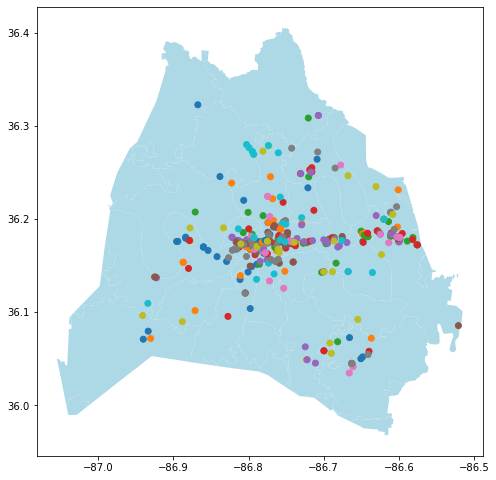

In [24]:
ax = zipcodes.plot(figsize = (8, 10), color = 'lightblue')
tornado911_by_zip.plot(ax = ax, column = 'date_time')
plt.show();

In [25]:
tornado_map = folium.Map(location =  (36.25, -86.7) , zoom_start = 10)

folium.GeoJson(zipcodes).add_to(tornado_map)

for row_index, row_values in tornado911_by_zip.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values['date_time']) + ': ' + str(row_values['cell_tower_address'])
    icon=folium.Icon(color="red",icon="exclamation", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop, icon = icon) 

    marker.add_to(tornado_map)

tornado_map

# Plotting 911 Call Points - Derecho

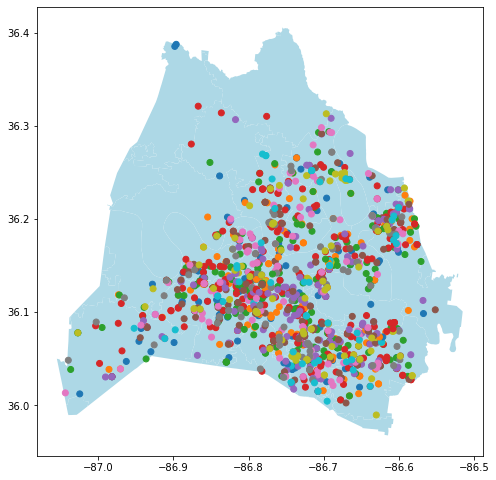

In [26]:
ax = zipcodes.plot(figsize = (8, 10), color = 'lightblue')
derecho911_by_zip.plot(ax = ax, column = 'date_time')
plt.show();

In [27]:
derecho_cluster_map = folium.Map(location = (36.25, -86.7), zoom_start = 10)

marker_cluster = MarkerCluster().add_to(derecho_cluster_map)

folium.GeoJson(zipcodes).add_to(derecho_cluster_map)

for row_index, row_values in derecho911_by_zip.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = str(row_values['date_time']) + ': ' + str(row_values['cell_tower_address'])
    icon=folium.Icon(color="red",icon="exclamation", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)

derecho_cluster_map

# Reading in Population Data

In [28]:
population = pd.read_csv('../data/pop_by_zip_clean.csv')
population.head()

,zipcode,population
0,37013,"97,819"
1,37042,"77,168"
2,37211,"76,834"
3,37075,"65,123"
4,37167,"59,055"


In [29]:
population.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 615 entries, 0 to 614
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   zipcode     615 non-null    int64 
 1   population  615 non-null    object
dtypes: int64(1), object(1)
memory usage: 9.7+ KB


In [30]:
population["population"]=population["population"].str.replace(',','').astype(int)
population.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 615 entries, 0 to 614
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype
---  ------      --------------  -----
 0   zipcode     615 non-null    int64
 1   population  615 non-null    int32
dtypes: int32(1), int64(1)
memory usage: 7.3 KB


In [31]:
zipcodes["zipcode"]=zipcodes["zipcode"].astype(int)
zipcodes.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 56 entries, 0 to 55
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   zipcode       56 non-null     int32   
 1   po_name       56 non-null     object  
 2   shape_length  56 non-null     object  
 3   shape_area    56 non-null     object  
 4   geometry      56 non-null     geometry
dtypes: geometry(1), int32(1), object(3)
memory usage: 2.1+ KB


In [32]:
pop_by_zip = pd.merge(left = zipcodes, right = population, 
                    left_on = 'zipcode', right_on = 'zipcode')
pop_by_zip.head()

,zipcode,po_name,shape_length,shape_area,geometry,population
0,37115,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ...",40484
1,37216,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ...",18609
2,37204,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ...",14768
3,37027,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ...",55130
4,37027,BRENTWOOD,3116.4327152718852,304596.06201171875,"MULTIPOLYGON (((-86.72012 36.00886, -86.72012 ...",55130


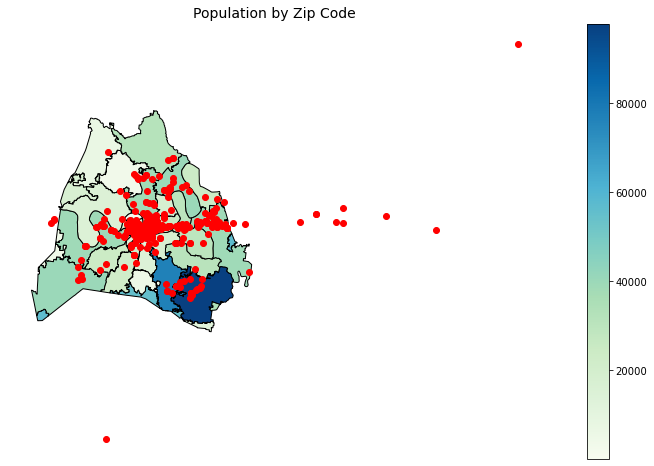

In [33]:
fig, ax = plt.subplots(figsize=(16, 8))
pop_by_zip.plot(column = 'population', 
              cmap = 'GnBu',
              edgecolor = 'black', 
              legend = True,
              ax = ax)
tornado_911_geo.plot(ax=ax, color = 'red')
plt.title('Population by Zip Code', fontsize = 14)
ax.axis('off');

In [34]:
tornado_911.shape

(475, 6)

In [35]:
tornado911_by_zip.shape

(434, 10)

In [36]:
pop_geo = pd.merge(zipcodes, population, 
                               left_on = 'zipcode', right_on = 'zipcode', 
                               how = 'outer')
pop_geo.head(10)

,zipcode,po_name,shape_length,shape_area,geometry,population
0,37115,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ...",40484.0
1,37216,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ...",18609.0
2,37204,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ...",14768.0
3,37027,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ...",55130.0
4,37027,BRENTWOOD,3116.4327152718852,304596.06201171875,"MULTIPOLYGON (((-86.72012 36.00886, -86.72012 ...",55130.0
5,37027,BRENTWOOD,30401.649619169264,24460979.921020508,"MULTIPOLYGON (((-86.68705 36.01059, -86.68695 ...",55130.0
6,37027,BRENTWOOD,524.2364158788497,5803.0636596679687,"MULTIPOLYGON (((-86.72541 36.00934, -86.72540 ...",55130.0
7,37027,BRENTWOOD,3028.3872771754991,553384.08331298828,"MULTIPOLYGON (((-86.68475 35.99279, -86.68488 ...",55130.0
8,37027,BRENTWOOD,1678.1723515222479,156012.904296875,"MULTIPOLYGON (((-86.68367 35.99140, -86.68419 ...",55130.0
9,37027,BRENTWOOD,1315.615824819155,78289.863037109375,"MULTIPOLYGON (((-86.67793 35.98782, -86.67941 ...",55130.0


In [37]:
pop_geo = gpd.GeoDataFrame(pop_geo,
                                  crs = zipcodes.crs,
                                  geometry = pop_geo['geometry'])

In [38]:
pop_geo.head()

,zipcode,po_name,shape_length,shape_area,geometry,population
0,37115,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ...",40484.0
1,37216,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ...",18609.0
2,37204,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ...",14768.0
3,37027,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ...",55130.0
4,37027,BRENTWOOD,3116.4327152718852,304596.06201171875,"MULTIPOLYGON (((-86.72012 36.00886, -86.72012 ...",55130.0


# Creating chorpleth overlayed on folium - tornado

In [39]:
tornado911_zip_pop = gpd.sjoin(tornado_911_geo, pop_geo, op = 'within')
tornado911_zip_pop.head()

,date_time,call_type,lat,lng,cell_tower_address,geometry,index_right,zipcode,po_name,shape_length,shape_area,population
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,POINT (-86.66578 36.07271),53,37013,ANTIOCH,349164.88029162859,1150567551.5894165,97819.0
10,3/3/2020 0:38,911 Calls,36.052055,-86.648331,745 BELL RD - OMNI Sector,POINT (-86.64833 36.05206),53,37013,ANTIOCH,349164.88029162859,1150567551.5894165,97819.0
64,3/3/2020 0:53,911 Calls,36.050048,-86.650629,5646 AMALIE DR - SE,POINT (-86.65063 36.05005),53,37013,ANTIOCH,349164.88029162859,1150567551.5894165,97819.0
194,3/3/2020 1:29,911 Calls,36.068298,-86.681550,3930 APACHE TRAIL - SE SECTOR,POINT (-86.68155 36.06830),53,37013,ANTIOCH,349164.88029162859,1150567551.5894165,97819.0
234,3/3/2020 1:40,911 Calls,36.058578,-86.699745,5067 COLEMONT DR - N,POINT (-86.69974 36.05858),53,37013,ANTIOCH,349164.88029162859,1150567551.5894165,97819.0


In [40]:
tornado911_zip_pop.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 434 entries, 0 to 232
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   date_time           434 non-null    object  
 1   call_type           434 non-null    object  
 2   lat                 434 non-null    float64 
 3   lng                 434 non-null    float64 
 4   cell_tower_address  434 non-null    object  
 5   geometry            434 non-null    geometry
 6   index_right         434 non-null    int64   
 7   zipcode             434 non-null    int64   
 8   po_name             434 non-null    object  
 9   shape_length        434 non-null    object  
 10  shape_area          434 non-null    object  
 11  population          433 non-null    float64 
dtypes: float64(3), geometry(1), int64(2), object(6)
memory usage: 44.1+ KB


In [41]:

cluster_map_911_tornado = folium.Map(location = (36.174465,-86.767960), zoom_start = 12)

marker_cluster = MarkerCluster().add_to(cluster_map_911_tornado)

folium.GeoJson(zipcodes).add_to(cluster_map_911_tornado)
cluster_map_911_tornado.choropleth(
 geo_data=zipcodes,
 name='choropleth',
 data=population,
 columns=['zipcode', 'population'],
 key_on='feature.properties.zipcode',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population'
)
folium.LayerControl().add_to(cluster_map_911_tornado)

folium.LayerControl().add_to(cluster_map_911_tornado)

for row_index, row_values in tornado911_zip_pop.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = '<b>ZIP code:</b> ' + str(row_values['zipcode']) + ' ' + '<b>Date/Time:</b> ' + str(row_values['date_time']) + ' ' + '<b>Address:</b> ' + str(row_values['cell_tower_address'])
    icon=folium.Icon(color="red",icon="phone", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)

cluster_map_911_tornado


C:\Users\evanr\anaconda3\envs\geospatial\lib\site-packages\folium\folium.py:411: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


# Creating chorpleth overlayed on folium - derecho

In [42]:
derecho911_zip_pop = gpd.sjoin(derecho_911_geo, pop_geo, op = 'within')
derecho911_zip_pop.head()

,date_time,call_type,lat,lng,cell_tower_address,geometry,index_right,zipcode,po_name,shape_length,shape_area,population
0,5/3/2020 16:30,911 Calls,36.247802,-86.716847,WIRELESS CALLER,POINT (-86.71685 36.24780),0,37115,MADISON,178783.02488886821,596553400.57885742,40484.0
68,5/3/2020 16:44,911 Calls,36.265547,-86.736116,524 BOYDS HILLTOP DR - SW,POINT (-86.73612 36.26555),0,37115,MADISON,178783.02488886821,596553400.57885742,40484.0
78,5/3/2020 16:46,911 Calls,36.250710,-86.689766,607E LARKIN SPRINGS RD - SW,POINT (-86.68977 36.25071),0,37115,MADISON,178783.02488886821,596553400.57885742,40484.0
79,5/3/2020 16:46,911 Calls,36.259485,-86.678717,96 D VANDIVER DR - SECTOR S,POINT (-86.67872 36.25948),0,37115,MADISON,178783.02488886821,596553400.57885742,40484.0
100,5/3/2020 16:51,911 Calls,36.253467,-86.730366,619 DUE WEST AVE. W - NE SECTOR,POINT (-86.73037 36.25347),0,37115,MADISON,178783.02488886821,596553400.57885742,40484.0


In [43]:
cluster_map_911_derecho = folium.Map(location = (36.174465,-86.767960), zoom_start = 12)

marker_cluster = MarkerCluster().add_to(cluster_map_911_derecho)

folium.GeoJson(zipcodes).add_to(cluster_map_911_derecho)
cluster_map_911_derecho.choropleth(
 geo_data=zipcodes,
 name='choropleth',
 data=population,
 columns=['zipcode', 'population'],
 key_on='feature.properties.zipcode',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population'
)
folium.LayerControl().add_to(cluster_map_911_derecho)

folium.LayerControl().add_to(cluster_map_911_derecho)

for row_index, row_values in derecho911_zip_pop.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = '<b>ZIP code:</b> ' + str(row_values['zipcode']) + ' ' + '<b>Date/Time:</b> ' + str(row_values['date_time']) + ' ' + '<b>Address:</b> ' + str(row_values['cell_tower_address'])
    icon=folium.Icon(color="red",icon="phone", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)

cluster_map_911_derecho

C:\Users\evanr\anaconda3\envs\geospatial\lib\site-packages\folium\folium.py:411: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


In [44]:
tornado_call_pct = pd.read_csv('../data/tornado_call_pct.csv')
tornado_call_pct.head()

,zipcode,population,call_count,pct_calls
0,37013,"97,819",17,0.173790
1,37211,"76,834",5,0.065075
2,37115,"40,484",12,0.296413
3,37221,"40,425",3,0.074212
4,37076,"38,957",56,1.437482


# Creating Map Showing Number of Calls Per ZIP code - Tornado

In [45]:
tornado_call_pct = pd.merge(left = zipcodes, right = tornado_call_pct, 
                    left_on = 'zipcode', right_on = 'zipcode')
pop_by_zip.head()

,zipcode,po_name,shape_length,shape_area,geometry,population
0,37115,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ...",40484
1,37216,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ...",18609
2,37204,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ...",14768
3,37027,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ...",55130
4,37027,BRENTWOOD,3116.4327152718852,304596.06201171875,"MULTIPOLYGON (((-86.72012 36.00886, -86.72012 ...",55130


In [46]:
tornado_call_pct['lng'] = tornado_call_pct['geometry'].centroid.x
tornado_call_pct['lat'] = tornado_call_pct['geometry'].centroid.y
tornado_call_pct.head()

<ipython-input-46-172c0fffb082>:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  tornado_call_pct['lng'] = tornado_call_pct['geometry'].centroid.x
<ipython-input-46-172c0fffb082>:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  tornado_call_pct['lat'] = tornado_call_pct['geometry'].centroid.y


,zipcode,po_name,shape_length,shape_area,geometry,population,call_count,pct_calls,lng,lat
0,37115,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ...","40,484",12,0.296413,-86.694767,36.254325
1,37216,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ...","18,609",3,0.161212,-86.726346,36.216050
2,37204,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ...","14,768",1,0.067714,-86.774666,36.105663
3,37080,JOELTON,2319.8074237329579,56522.611450195313,"MULTIPOLYGON (((-86.86263 36.37811, -86.86264 ...","7,349",1,0.136073,-86.862633,36.380012
4,37080,JOELTON,258036.51004561348,868231536.13537598,"MULTIPOLYGON (((-86.90742 36.39053, -86.90725 ...","7,349",1,0.136073,-86.894874,36.320341


In [57]:
tornado_map_call_pct = folium.Map(location = (36.174465,-86.767960), zoom_start = 10.25)

folium.GeoJson(zipcodes).add_to(tornado_map_call_pct)
tornado_map_call_pct.choropleth(
 geo_data=zipcodes,
 name='choropleth',
 data=tornado_call_pct,
 columns=['zipcode', 'call_count'],
 key_on='feature.properties.zipcode',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population'
)
folium.LayerControl().add_to(tornado_map_call_pct)

folium.LayerControl().add_to(tornado_map_call_pct)

for row_index, row_values in tornado_call_pct.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = '<b>ZIP code:</b>' + ' ' + str(row_values['zipcode']) + ' ' + '<b>Population:</b>' + ' ' + str(row_values['population']) + ' ' + '<b>Caller Rate (Per 1,000):</b>' + ' ' + str(row_values['pct_calls'])
    icon=folium.Icon(color="blue",icon="map-pin", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(tornado_map_call_pct)

tornado_map_call_pct


In [48]:
tornado911_zip_pop.head()

,date_time,call_type,lat,lng,cell_tower_address,geometry,index_right,zipcode,po_name,shape_length,shape_area,population
0,3/3/2020 0:34,911 Calls,36.072708,-86.665779,620 Richards RD - N Sector,POINT (-86.66578 36.07271),53,37013,ANTIOCH,349164.88029162859,1150567551.5894165,97819.0
10,3/3/2020 0:38,911 Calls,36.052055,-86.648331,745 BELL RD - OMNI Sector,POINT (-86.64833 36.05206),53,37013,ANTIOCH,349164.88029162859,1150567551.5894165,97819.0
64,3/3/2020 0:53,911 Calls,36.050048,-86.650629,5646 AMALIE DR - SE,POINT (-86.65063 36.05005),53,37013,ANTIOCH,349164.88029162859,1150567551.5894165,97819.0
194,3/3/2020 1:29,911 Calls,36.068298,-86.681550,3930 APACHE TRAIL - SE SECTOR,POINT (-86.68155 36.06830),53,37013,ANTIOCH,349164.88029162859,1150567551.5894165,97819.0
234,3/3/2020 1:40,911 Calls,36.058578,-86.699745,5067 COLEMONT DR - N,POINT (-86.69974 36.05858),53,37013,ANTIOCH,349164.88029162859,1150567551.5894165,97819.0


# Creating Map Showing Number of Calls Per ZIP code - Derecho

In [49]:
derecho_call_pct = pd.read_csv('../data/derecho_call_pct.csv')
derecho_call_pct.head()

,zipcode,population,call_count,call_pct
0,37013,"97,819",191,1.952586
1,37211,"76,834",194,2.524924
2,37122,"56,964",1,0.017555
3,37027,"55,130",20,0.362779
4,37115,"40,484",52,1.284458


In [50]:
derecho_call_pct = pd.merge(left = zipcodes, right = derecho_call_pct, 
                    left_on = 'zipcode', right_on = 'zipcode')
derecho_call_pct.head()

,zipcode,po_name,shape_length,shape_area,geometry,population,call_count,call_pct
0,37115,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ...","40,484",52,1.284458
1,37216,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ...","18,609",20,1.074749
2,37204,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ...","14,768",58,3.927411
3,37027,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ...","55,130",20,0.362779
4,37027,BRENTWOOD,3116.4327152718852,304596.06201171875,"MULTIPOLYGON (((-86.72012 36.00886, -86.72012 ...","55,130",20,0.362779


In [51]:
derecho_call_pct['lng'] = derecho_call_pct['geometry'].centroid.x
derecho_call_pct['lat'] = derecho_call_pct['geometry'].centroid.y
derecho_call_pct.head()

<ipython-input-51-3e6d08286729>:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  derecho_call_pct['lng'] = derecho_call_pct['geometry'].centroid.x
<ipython-input-51-3e6d08286729>:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  derecho_call_pct['lat'] = derecho_call_pct['geometry'].centroid.y


,zipcode,po_name,shape_length,shape_area,geometry,population,call_count,call_pct,lng,lat
0,37115,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ...","40,484",52,1.284458,-86.694767,36.254325
1,37216,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ...","18,609",20,1.074749,-86.726346,36.216050
2,37204,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ...","14,768",58,3.927411,-86.774666,36.105663
3,37027,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ...","55,130",20,0.362779,-86.785510,36.041482
4,37027,BRENTWOOD,3116.4327152718852,304596.06201171875,"MULTIPOLYGON (((-86.72012 36.00886, -86.72012 ...","55,130",20,0.362779,-86.722258,36.009377


In [56]:
derecho_map_call = folium.Map(location = (36.174465,-86.767960), zoom_start = 10.25)

folium.GeoJson(zipcodes).add_to(derecho_map_call)
derecho_map_call.choropleth(
 geo_data=zipcodes,
 name='choropleth',
 data=tornado_call_pct,
 columns=['zipcode', 'call_count'],
 key_on='feature.properties.zipcode',
 fill_color='YlGn',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Population'
)
folium.LayerControl().add_to(derecho_map_call)

folium.LayerControl().add_to(derecho_map_call)

for row_index, row_values in derecho_call_pct.iterrows():
    loc = [row_values['lat'], row_values['lng']]
    pop = '<b>ZIP code:</b>' + ' ' + str(row_values['zipcode']) + ' ' + '<b>Population:</b>' + ' ' + str(row_values['population']) + ' ' + '<b>Caller Rate (Per 1,000):</b>' + ' ' + str(row_values['call_pct'])
    icon=folium.Icon(color="blue",icon="map-pin", prefix='fa', radius=5)
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(derecho_map_call)

derecho_map_call

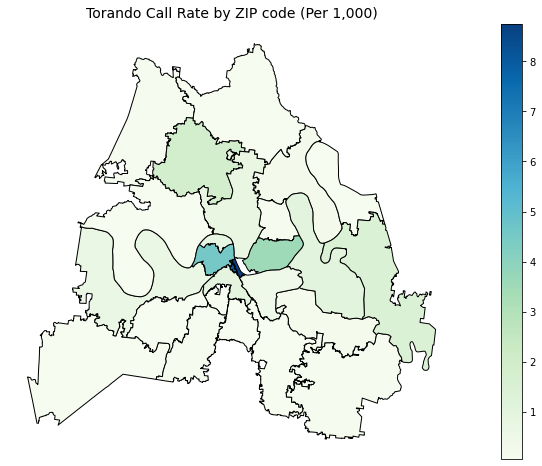

In [54]:
tornado_call_pct = tornado_call_pct[tornado_call_pct["zipcode"].isin(["37213"]) == False]
#removing the outlier

fig, ax = plt.subplots(figsize=(16, 8))
tornado_call_pct.plot(column = 'pct_calls', 
              cmap = 'GnBu',
              edgecolor = 'black', 
              legend = True,
              ax = ax)
plt.title('Torando Call Rate by ZIP code (Per 1,000)', fontsize = 14)
ax.axis('off');